In [1]:
import requests
import pandas as pd
import json
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
url = 'https://parseapi.back4app.com/classes/Brazilzipcode_CEP?limit=100000'
headers = {
    'X-Parse-Application-Id': 'kwkLhWDJi4IwTwlcgKhn6AHyz8CDp1f19O9w9XCa',
    'X-Parse-REST-API-Key': 'VFc3tJVBZGv4RMI5WLtyoELAQWfI1GzpYaxqsdwS'
}

response = requests.get(url, headers=headers)

In [3]:
response = requests.get(url, headers=headers)

# Verificar o status da resposta
print('Status Code:', response.status_code)

# Verificar o conteúdo da resposta antes de tentar carregar como JSON
print(response.content)

# Se o status code for 200 e o conteúdo parecer um JSON válido, prosseguir com json.loads
if response.status_code == 200:
    try:
        data = json.loads(response.content.decode('utf-8'))
        df = pd.DataFrame(data['results'])
        print(df.head())
    except json.JSONDecodeError as e:
        print('Decoding JSON has failed:', e)
else:
    print('Failed to retrieve data:', response.content)


Status Code: 200
b'{"results":[{"objectId":"b74XHFEeVf","CEP":"01001000","cidade":"S\xc3\xa3o Paulo","estado":"SP","bairro":"S\xc3\xa9","logradouro":"Pra\xc3\xa7a da S\xc3\xa9 - lado \xc3\xadmpar","numero":null,"createdAt":"2019-12-17T18:31:37.240Z","updatedAt":"2019-12-17T18:31:37.240Z"},{"objectId":"9glIZw1AP4","CEP":"01002010","cidade":"S\xc3\xa3o Paulo","estado":"SP","bairro":"S\xc3\xa9","logradouro":"Pra\xc3\xa7a do Patriarca","numero":null,"createdAt":"2019-12-17T18:31:37.241Z","updatedAt":"2019-12-17T18:31:37.241Z"},{"objectId":"2fEuvsYM9J","CEP":"01001900","cidade":"S\xc3\xa3o Paulo","estado":"SP","bairro":"S\xc3\xa9","logradouro":"Pra\xc3\xa7a da S\xc3\xa9","numero":108,"info":" UNESP - Universidade Estadual J\xc3\xbalio de Mesquita Filho","createdAt":"2019-12-17T18:31:37.241Z","updatedAt":"2019-12-17T18:31:37.241Z"},{"objectId":"xCkm4Fn1PB","CEP":"01001001","cidade":"S\xc3\xa3o Paulo","estado":"SP","bairro":"S\xc3\xa9","logradouro":"Pra\xc3\xa7a da S\xc3\xa9 - lado par","nume

In [4]:
df.head()

,objectId,CEP,cidade,estado,bairro,logradouro,numero,createdAt,updatedAt,info
0,b74XHFEeVf,01001000,São Paulo,SP,Sé,Praça da Sé - lado ímpar,NaN,2019-12-17T18:31:37.240Z,2019-12-17T18:31:37.240Z,NaN
1,9glIZw1AP4,01002010,São Paulo,SP,Sé,Praça do Patriarca,NaN,2019-12-17T18:31:37.241Z,2019-12-17T18:31:37.241Z,NaN
2,2fEuvsYM9J,01001900,São Paulo,SP,Sé,Praça da Sé,108.0,2019-12-17T18:31:37.241Z,2019-12-17T18:31:37.241Z,UNESP - Universidade Estadual Júlio de Mesqui...
3,xCkm4Fn1PB,01001001,São Paulo,SP,Sé,Praça da Sé - lado par,NaN,2019-12-17T18:31:37.241Z,2019-12-17T18:31:37.241Z,NaN
4,B9Tb1Q225S,01002900,São Paulo,SP,Centro,Viaduto do Chá,15.0,2019-12-17T18:31:37.241Z,2019-12-17T18:31:37.241Z,Prefeitura do Município de São Paulo


Todas as variáveis auxiliam na granularidade de região, CEP, cidade, do, bairro e logradouro. A variável 'info' também é interessante para entender os comércios e outras instituições na região, como Universidades, Hospitais, etc.

In [5]:
df.describe()

,numero
count,4674.000000
mean,994.621095
std,2039.035570
min,0.000000
25%,181.000000
50%,439.000000
75%,1046.000000
max,39300.000000


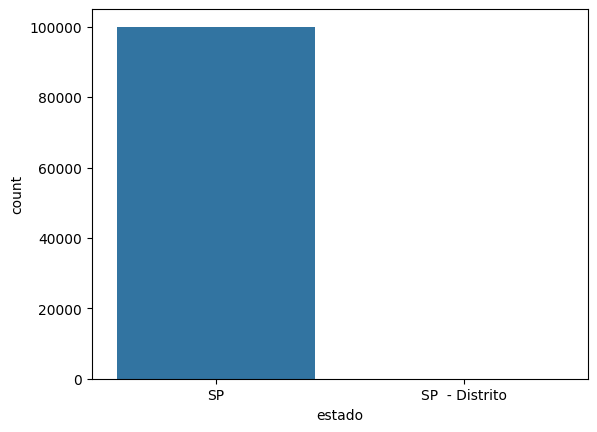

In [7]:
sns.countplot(x='estado', data=df)
plt.show()